# Final Project: Homicide Data Analysis using PySpark

Submitted by Srimanth Agastyaraju (sragas) as part of the coursework for the course INFO-I 535, Fall 2022.

## Introduction

In this notebook, we create a pipeline to explore the homicide reports in the United States. To establish a pipeline, I've used IU's Jetstream 2 as the cloud infrastructure. I've implemented my pipeline primarily in PySpark, with Pandas to collect the summary queries and Plotly for visualization.

This project fulfills the following criteria:

+ Run an algorithm using a parallel programming framework (using Hadoop or IU supercomputing resources) -> The PySpark SQL framework runs in parallel by default. The read.csv method converts the dataset into an RDD.
+ Implement a pipeline (e.g., download - transform - summarize - visualize) -> I have built a pipeline using PySpark, Pandas, and Plotly

**Dataset Source: https://www.kaggle.com/datasets/murderaccountability/homicide-reports**

## Background

Homicide is one of the leading causes of death. According to the CDC, All homicides - Number of deaths is 24,576 and Deaths per 100,000 population is 7.5. In this project, I hope to answer some questions by summarizing and visualizing the data. I've always been an avid reader of mystery novels. As a result, in the previous assignment "Data Analysis using PySpark", I chose to work on the Sherlock Holmes text data. In today's world of data analytics, equipped with the knowledge gained from this course, I believe I can play the role of a "Digital Detective".

### About the dataset
This dataset contains 638454 rows and 24 columns. Most of the columns in the dataset are categorical, with a few exceptions. The dataset is very clean, except for a few zeros in the age columns, which should not be present. We address some of these challenges in this project.

## Methodology

### Technological setup

The following steps were run: 
+ Created an m2.small instance on the J2 server.
+ Instance parameters: Ubuntu 20.4, m3.small, Web Desktop enabled.
+ Very similar to the assignment "Analyzing data with PySpark", the following commands were run:

```
sudo docker --version
nano docker-compose.yaml # Edited the file as outlined below
sudo docker-compose up # Starts the Jupyter Lab server
```

Contents of the docker-compose.yaml file

```
version: '3'
services:
  spark:
    image: jupyter/pyspark-notebook
    ports:
      - "8888:8888"
      - "4040-4080:4040-4080"
    volumes:
      - ./notebooks:/home/jovyan/work/notebooks/?
```

The following python packages were installed in the environment:

```
pip3 install numpy pandas matplotlib seaborn plotly geopandas
```

### Steps in the pipeline

In this pipeline, I have been able to answer the following questions:

+ Top 20 Cities with the highest crime
+ Number of homicides detected by each agency
+ Number of homicides detected by each state
+ Number of homicides per month
+ Number of homicides detected by the nature of the crime
+ Number of homicides detected - if the crime is solved or not
+ Number of homicides detected by the ethnicity of the victim
+ Number of homicides detected by the sex of the perpetrator
+ Number of homicides detected by the race of the perpetrator
+ Number of homicides - Relationship between the perpetrator and the victim
+ Number of homicides detected by each weapon
+ Number of homicides by the number of victims
+ Number of homicides by the records of agencies
+ Homicide count over time
+ Weapon of choice for different Perpetrator Sexes
+ Is there a weapon prominently seen in unsolved crimes?
+ Weapon of choice for a homicide where the perpetrator and the victim are strangers
+ Categorizing age by binning - Age groups of the perpetrators
+ Categorizing age by binning - Age groups of the victims
+ Is the perpetrator older than the victim?
+ Do the perpetrator and the victim share the same race?
+ Crime rate spread across the city

**NOTE: Plotly is a library to create interactive visualizations. In this notebook, you can interact with the plots by click and drag to zoom/pan, single click label to remove, and double click label to isolate.**

### J2 Instance creation

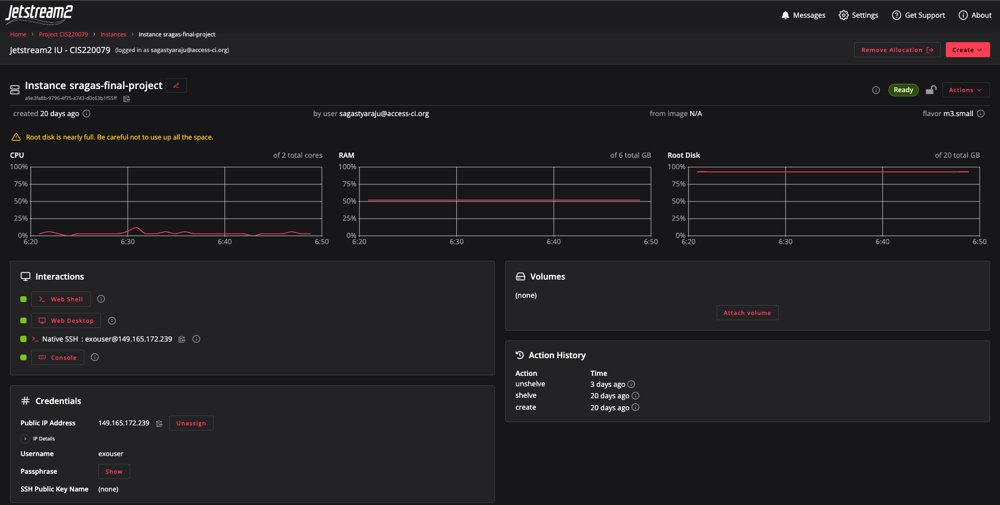

In [1]:
from IPython.display import Image
Image(filename='J2.png')

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import plotly.express as px
import plotly
import plotly.io as pio
import geopandas as gpd

from IPython.display import display, Markdown

plotly.offline.init_notebook_mode()
pio.templates.default = "simple_white"

# sns.set(rc={'figure.figsize':(11.7,8.27)})
# sns.set(font_scale=0.9)

In [3]:
from pyspark import SparkContext
from pyspark.sql import SQLContext
from pyspark.sql.functions import udf, col
from pyspark.sql.types import StringType
spark = SparkContext()
sql_sc = SQLContext(spark)
spark

/usr/local/spark/python/pyspark/sql/context.py:112: FutureWarning:

Deprecated in 3.0.0. Use SparkSession.builder.getOrCreate() instead.



<SparkContext master=local[*] appName=pyspark-shell>

In [4]:
dataframe = sql_sc.read.csv("./Data/homicide_reports.csv", header=True)

In [5]:
dataframe.show(2)

+---------+-----------+-----------+----------------+---------+------+----+-------+--------+--------------------+------------+----------+----------+--------------------+----------------+---------------+---------------+--------------------+---------------------+------------+-------------+------------+-----------------+-------------+
|Record ID|Agency Code|Agency Name|     Agency Type|     City| State|Year|  Month|Incident|          Crime Type|Crime Solved|Victim Sex|Victim Age|         Victim Race|Victim Ethnicity|Perpetrator Sex|Perpetrator Age|    Perpetrator Race|Perpetrator Ethnicity|Relationship|       Weapon|Victim Count|Perpetrator Count|Record Source|
+---------+-----------+-----------+----------------+---------+------+----+-------+--------+--------------------+------------+----------+----------+--------------------+----------------+---------------+---------------+--------------------+---------------------+------------+-------------+------------+-----------------+-------------+
|

In [6]:
CATEGORICAL_COLUMNS = list(dataframe.columns)
CATEGORICAL_COLUMNS.remove("Record ID")
CATEGORICAL_COLUMNS.remove("Agency Code")
CATEGORICAL_COLUMNS.remove("Agency Name")
CATEGORICAL_COLUMNS.remove("Victim Age")
CATEGORICAL_COLUMNS.remove("Perpetrator Age")
CATEGORICAL_COLUMNS.remove("City")
CATEGORICAL_COLUMNS.remove("Year")
CATEGORICAL_COLUMNS.remove("Incident")

In [7]:
def bar_or_pie_chart(df, x, y):
    length = len(df)
    if length > 5:
        title = f"Count plot for the column {x}"
        fig = px.bar(df, x=x, y=y, color=list(range(length)), color_continuous_scale="agsunset", title=title)
    else:
        title = f"Pie chart - {column}"
        fig = px.pie(df, values=y, names=x, title=title)
    fig.update_layout(width=1200, height=900)
    fig.update_coloraxes(showscale=False)
    fig.show()

## Results

### Count and Ratio Plots

#### Top 20 cities with the highest crime

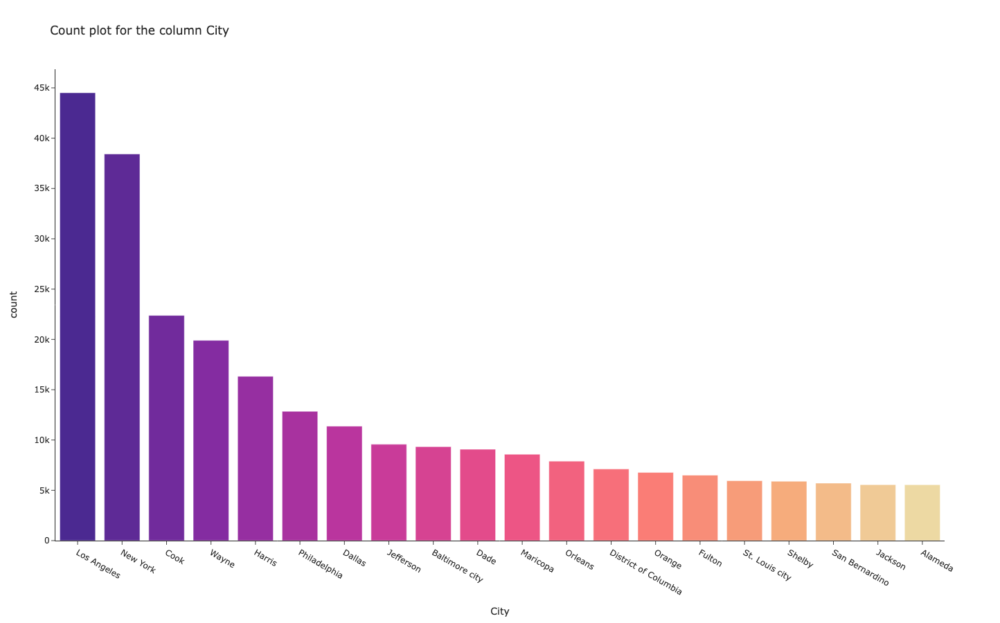

In [8]:
# Top 20 Cities with the highest crime
count_query = dataframe.groupBy("City").count().sort(col("count").desc()).toPandas().iloc[:20, :]
bar_or_pie_chart(count_query, "City", "count")

#### Number of homicides per Agency Type

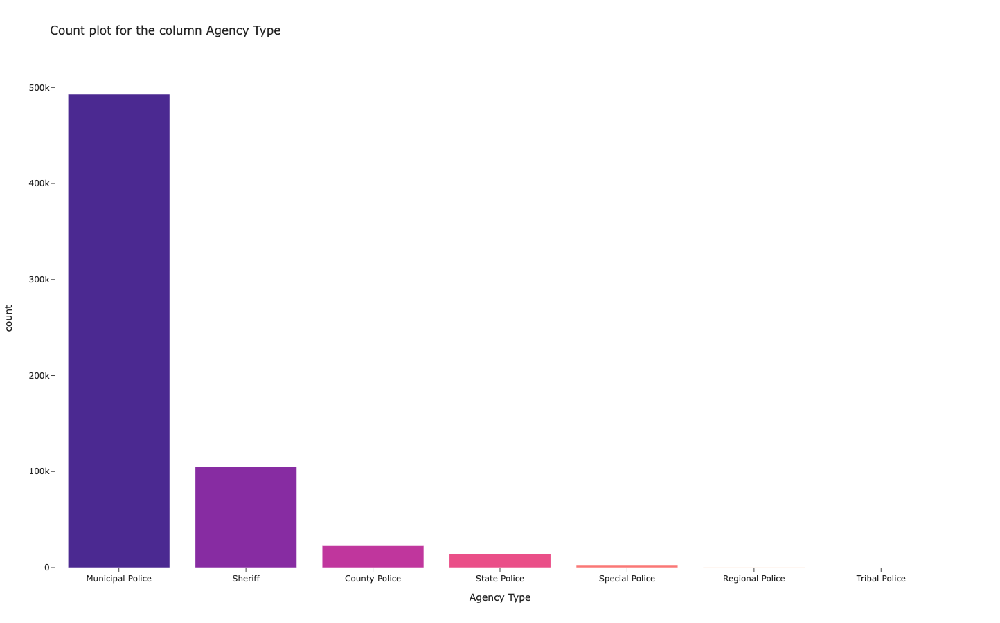

#### Number of homicides per State

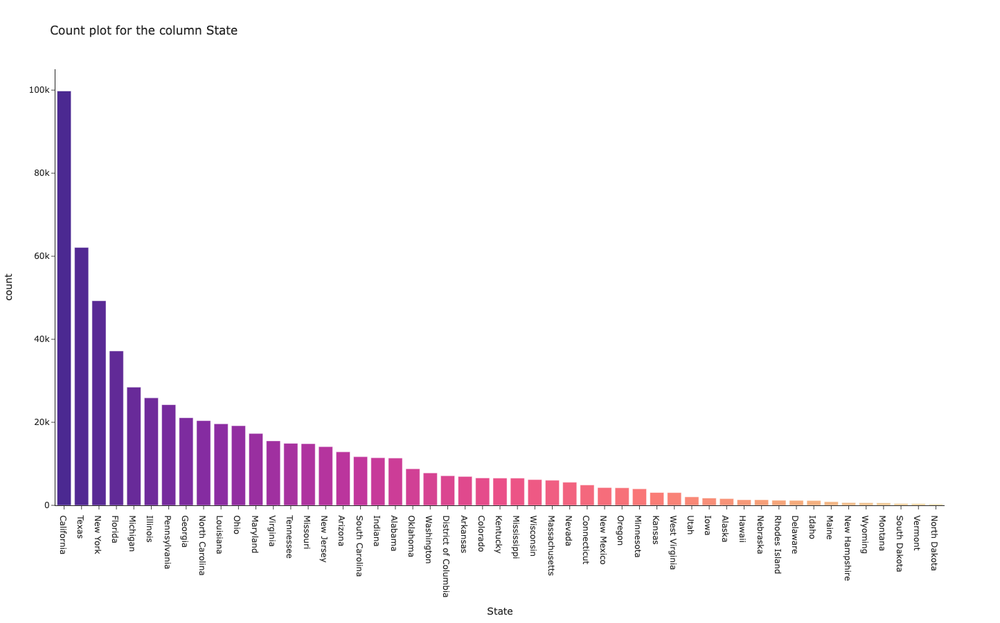

#### Number of homicides per Month

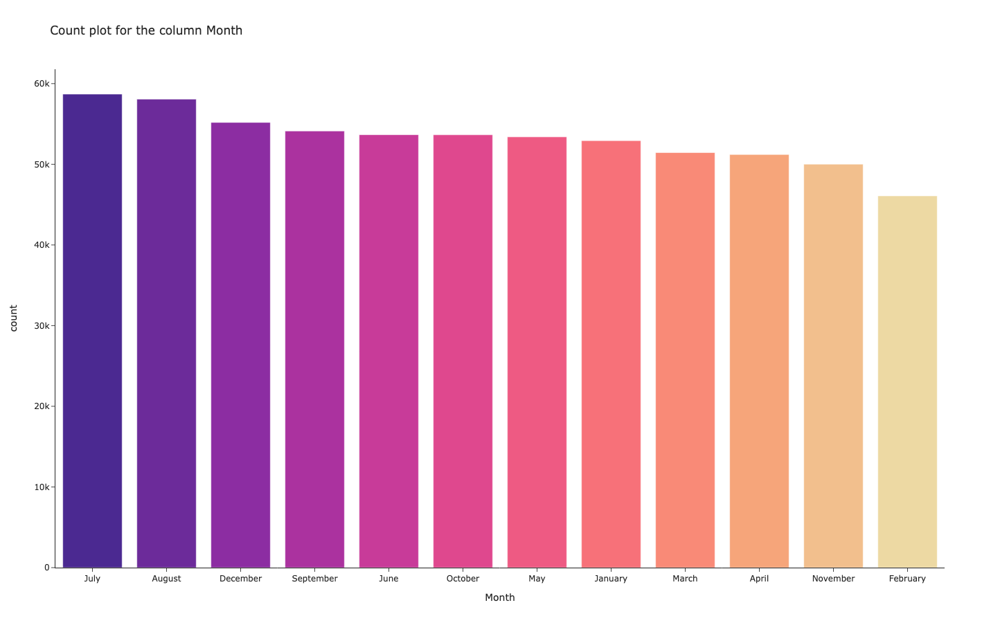

#### Number of homicides per Crime Type

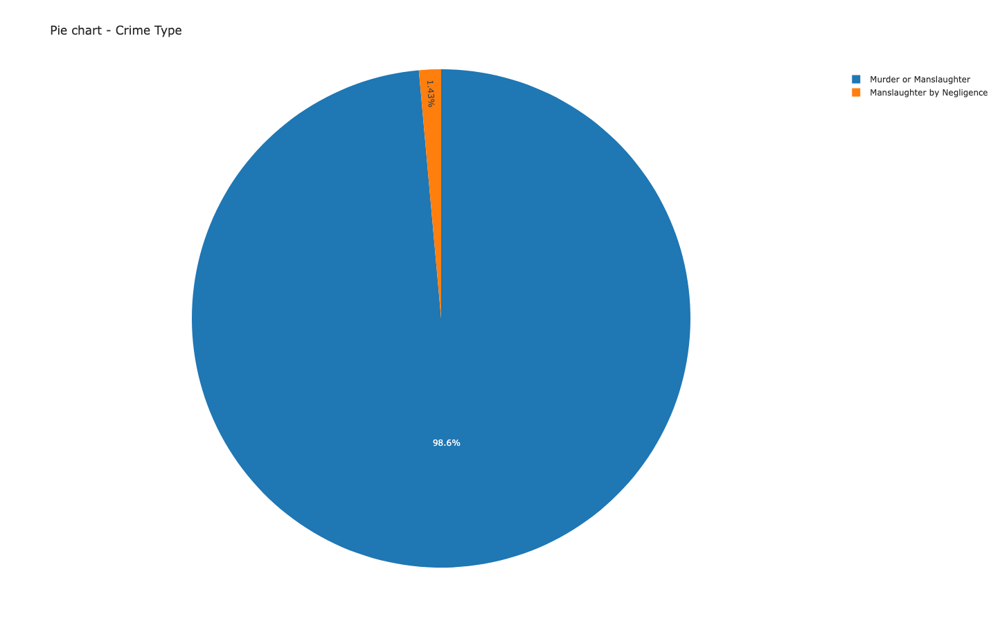

#### Number of homicides per Crime Solved

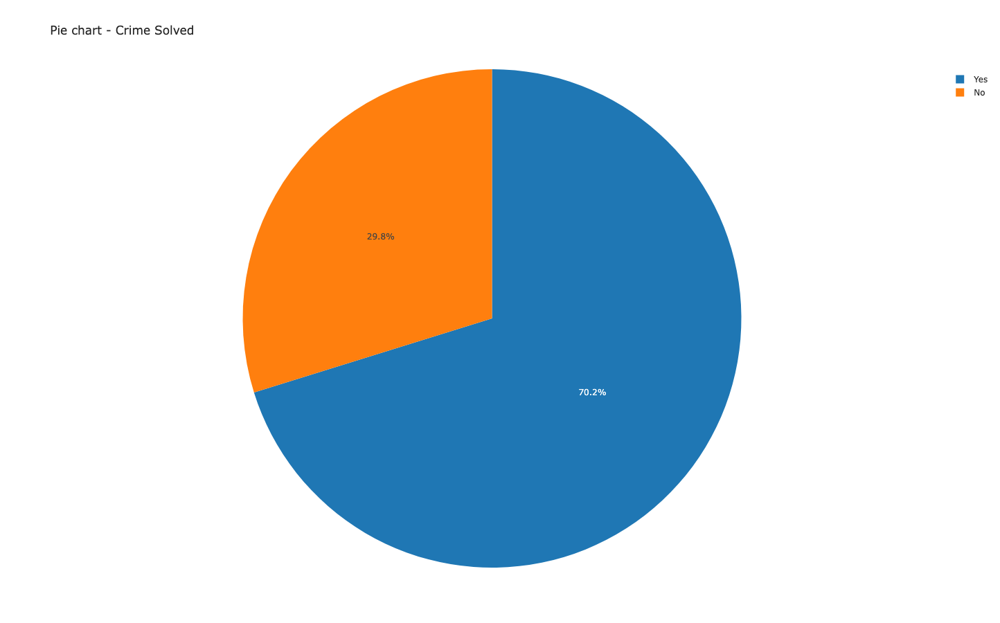

#### Number of homicides per Victim Sex

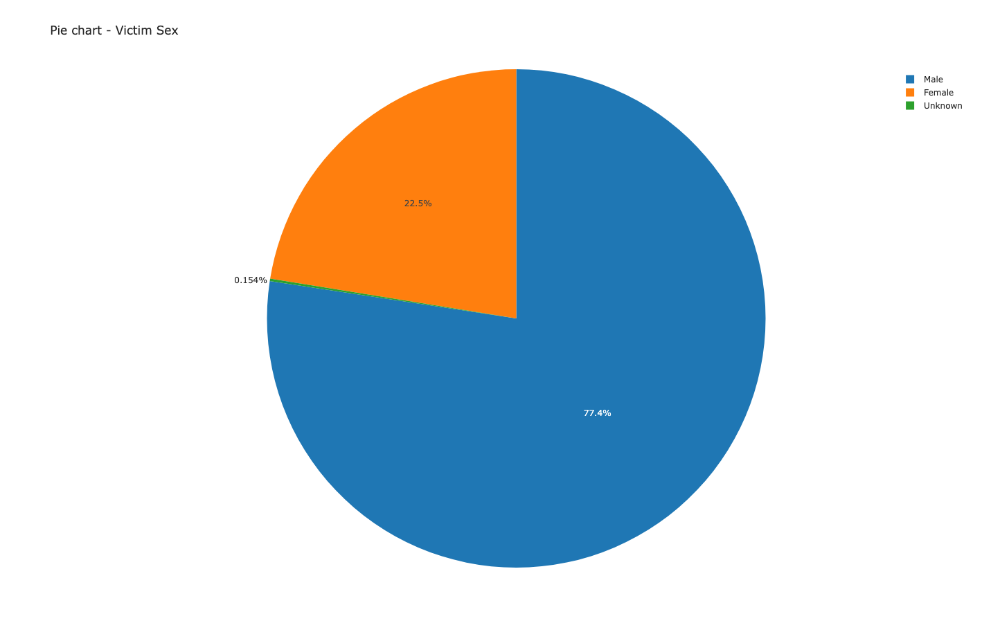

#### Number of homicides per Victim Race

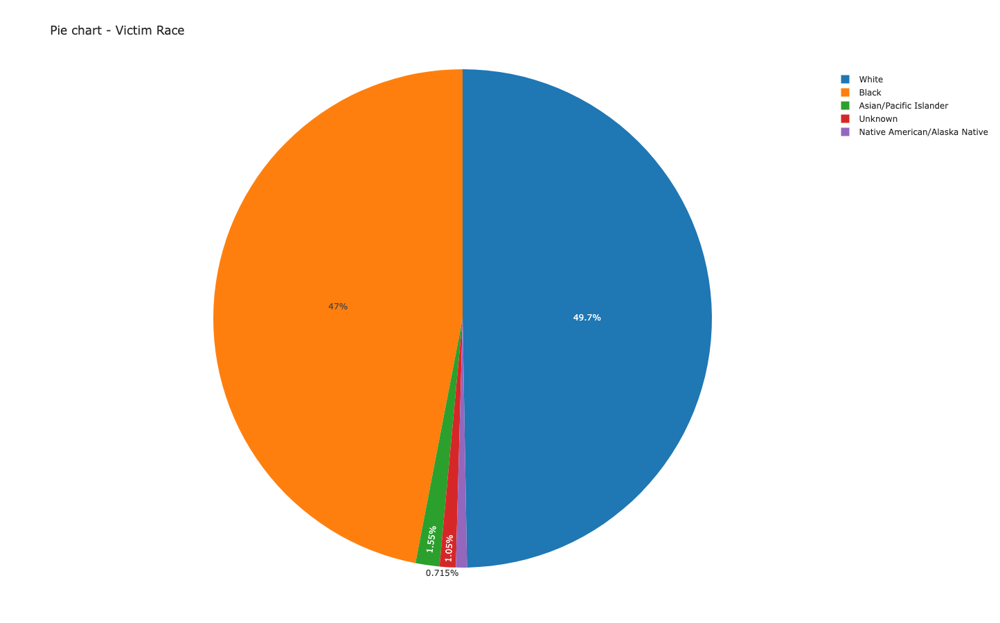

#### Number of homicides per Victim Ethnicity

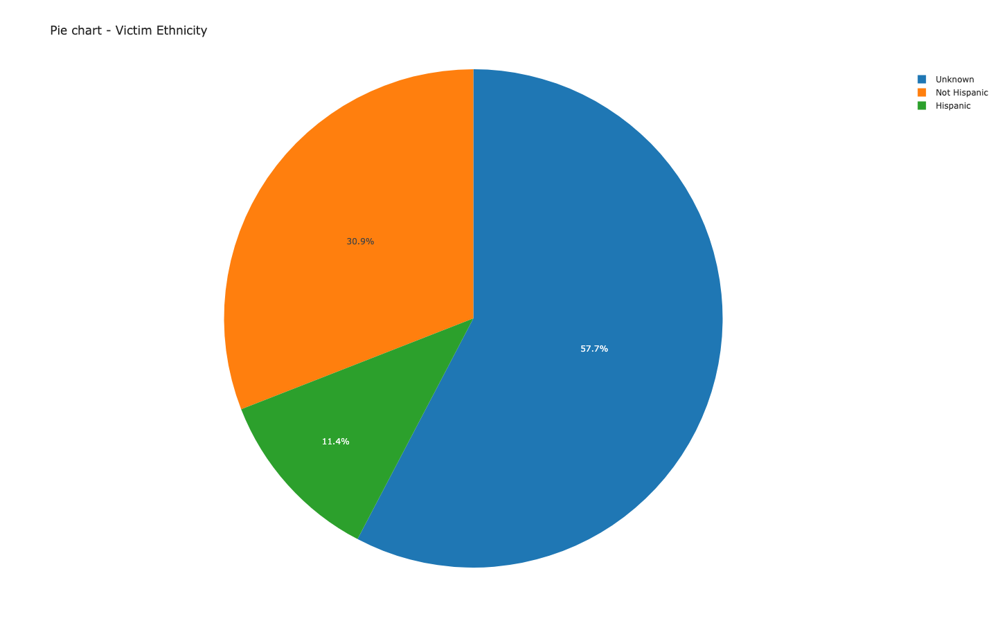

#### Number of homicides per Perpetrator Sex

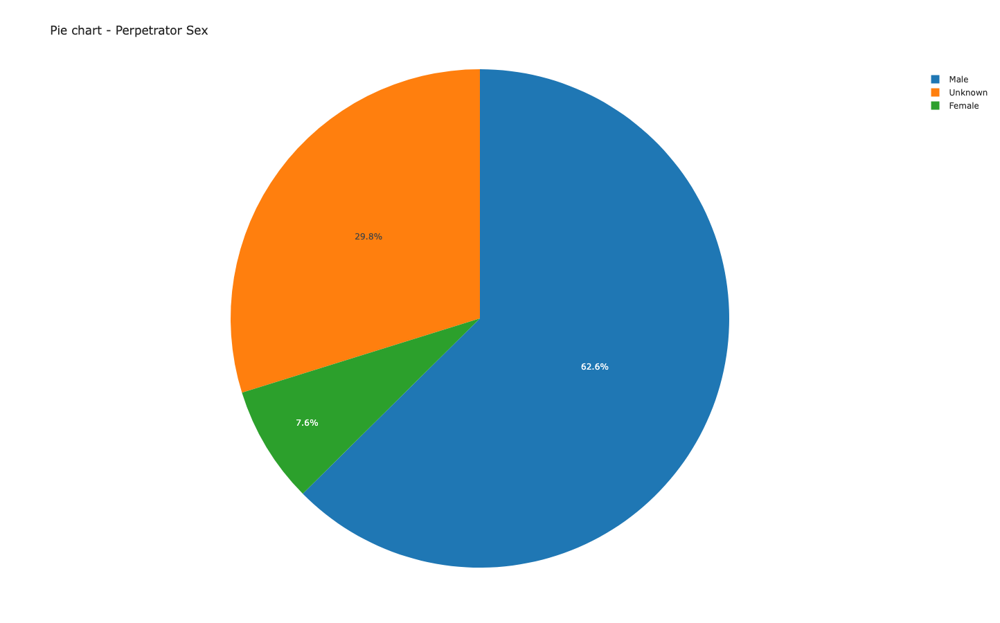

#### Number of homicides per Perpetrator Race

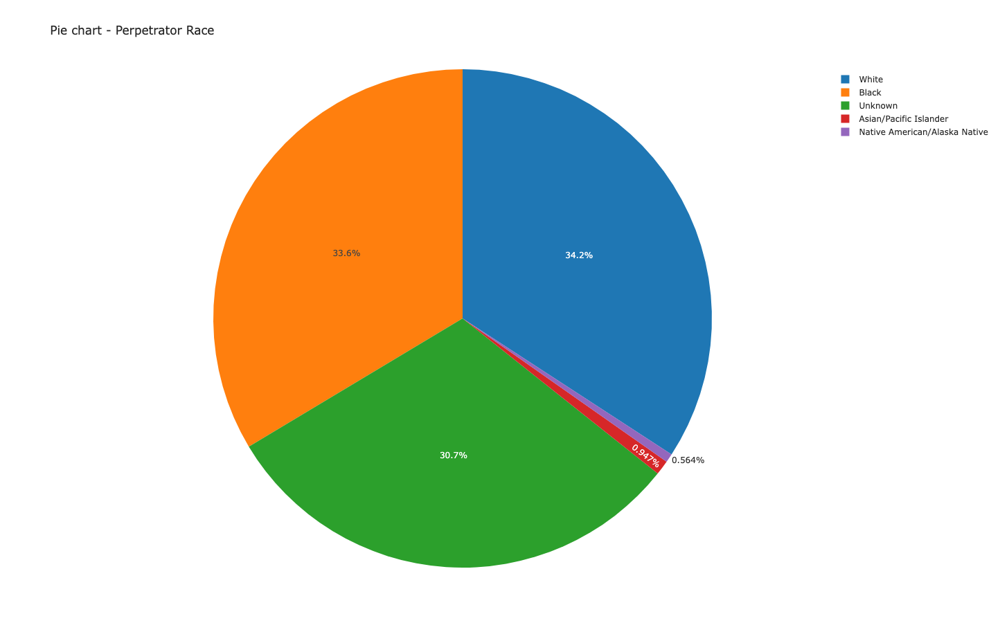

#### Number of homicides per Perpetrator Ethnicity

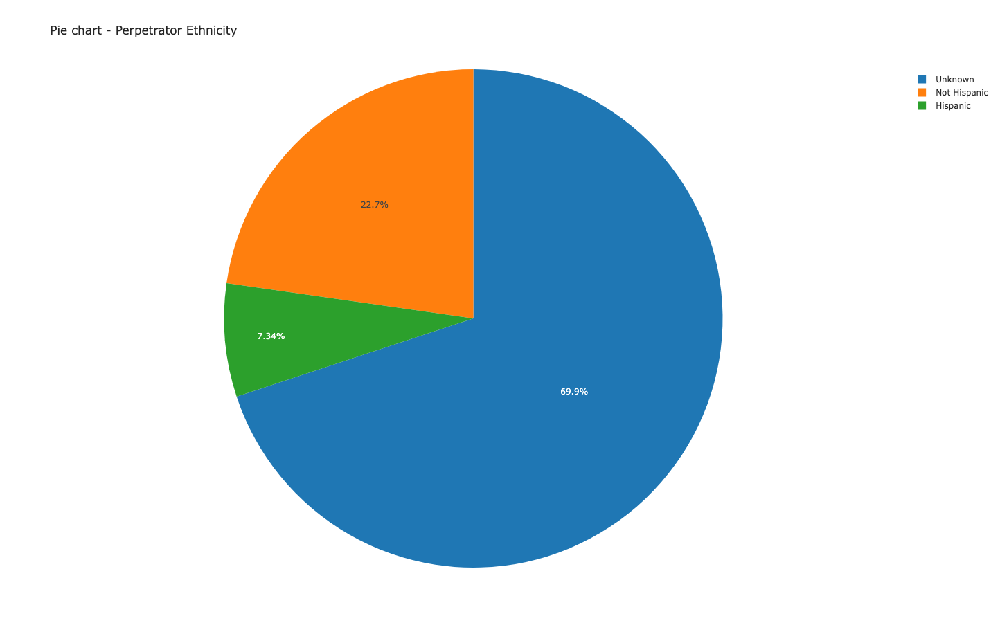

#### Number of homicides per Relationship

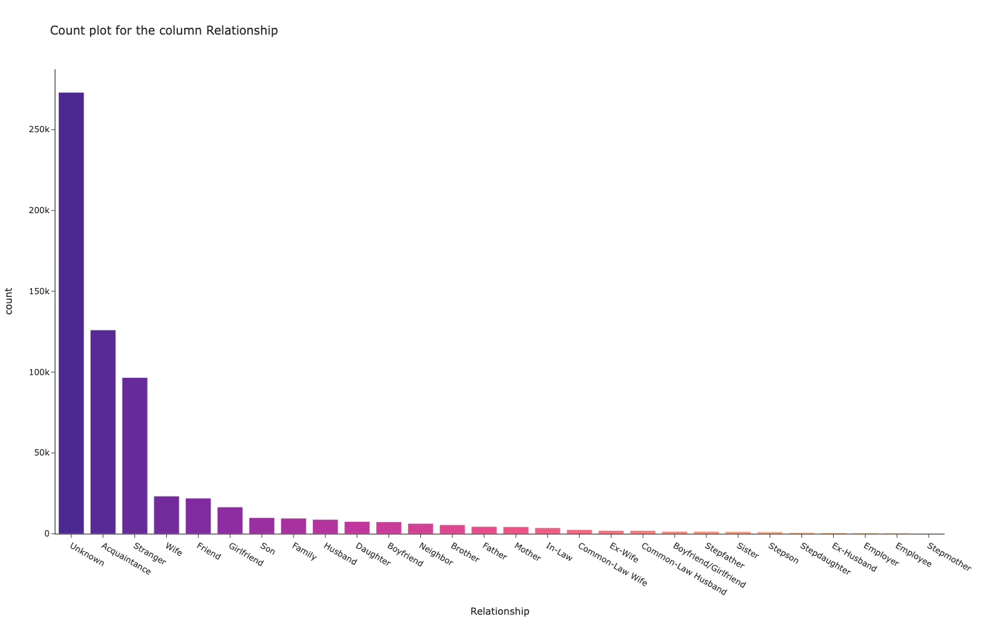

#### Number of homicides per Weapon

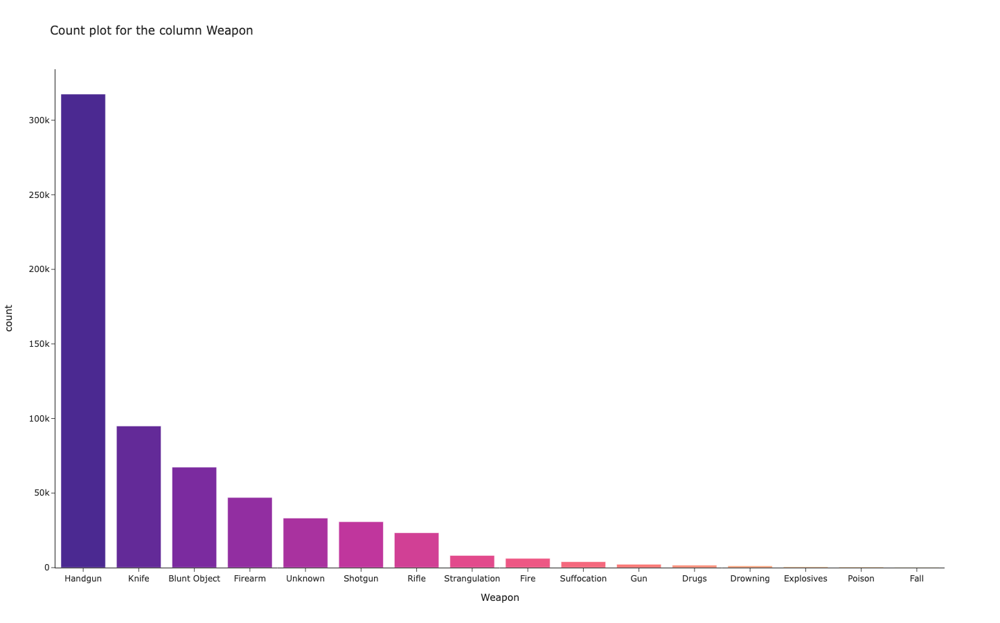

#### Number of homicides per Victim Count

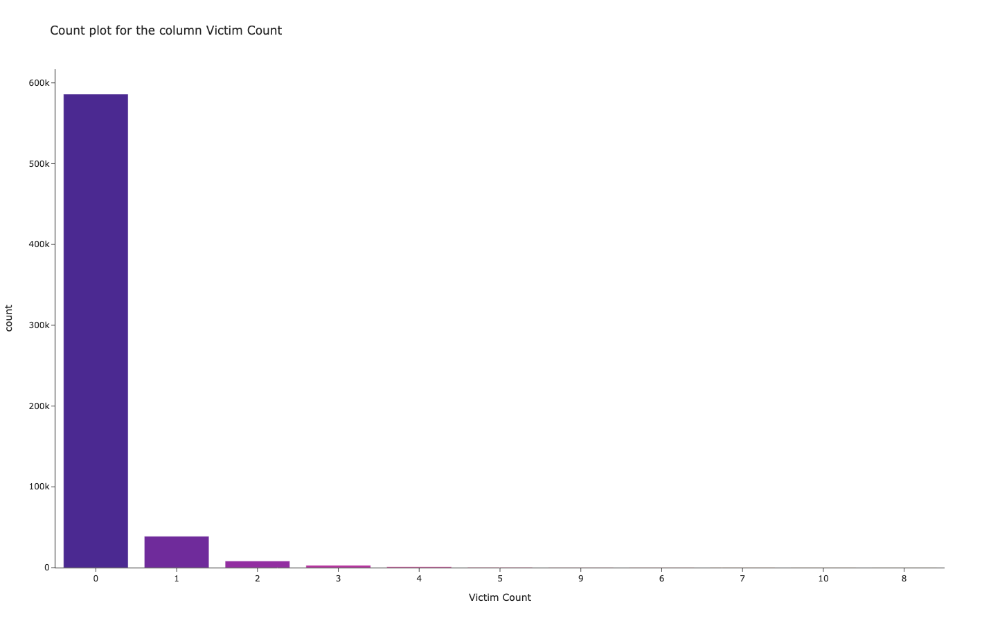

#### Number of homicides per Perpetrator Count

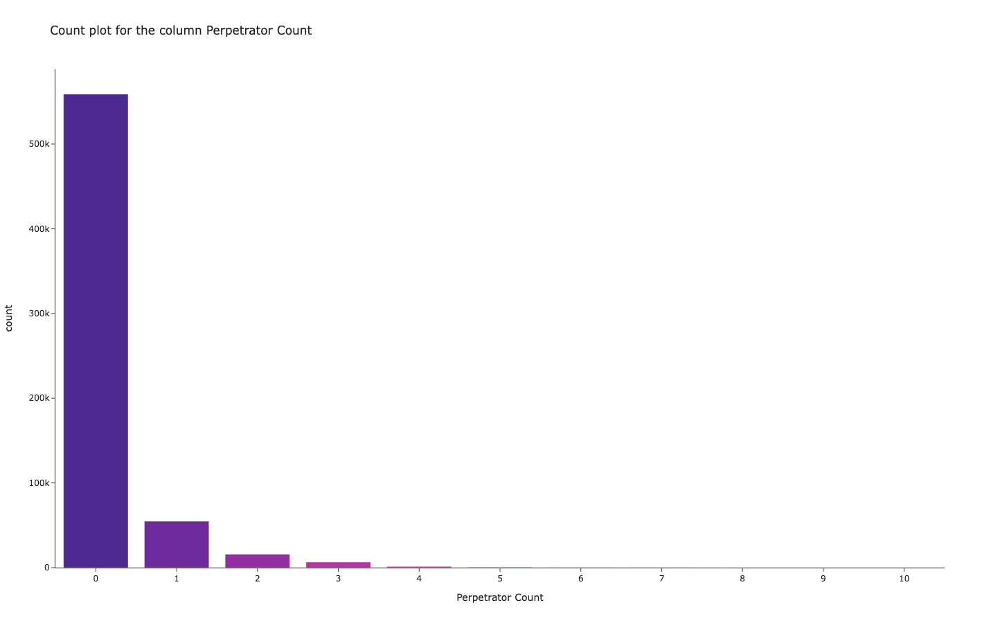

#### Number of homicides per Record Source

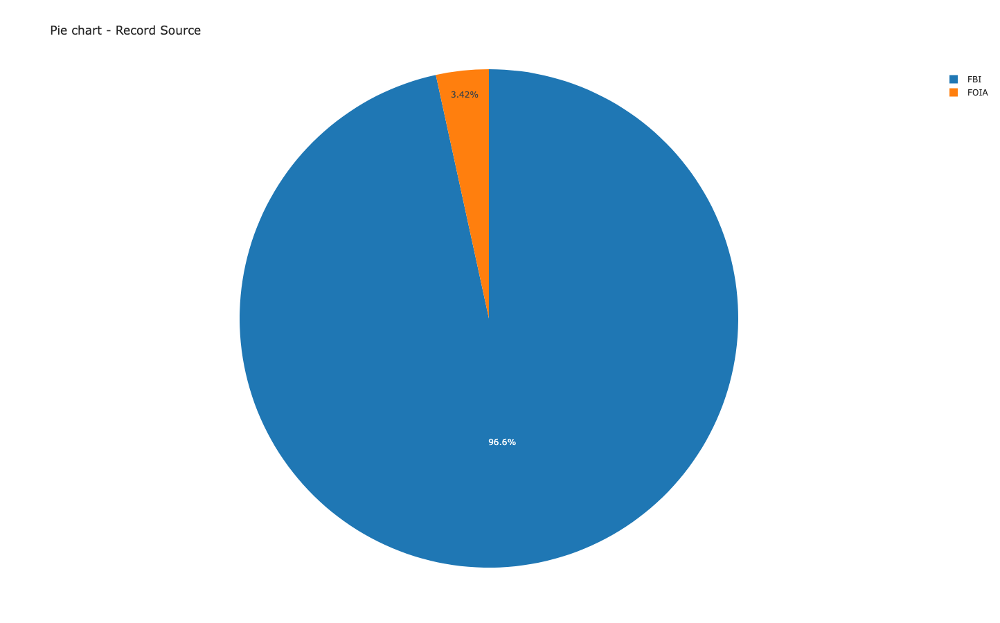

In [9]:
for column in CATEGORICAL_COLUMNS:
    count_query = dataframe.groupBy(column).count().sort(col("count").desc()).toPandas()
    display(Markdown(f"#### Number of homicides per {column}"))

    # sns.barplot(count_query, x=column, y="count").set_title(f"Count plot for the column {column}")
    # plt.xticks(
    #     rotation=45,
    #     horizontalalignment='right',
    # )
    # plt.tight_layout()
    # plt.show()

    bar_or_pie_chart(count_query, column, "count")

#### Homicide count over time

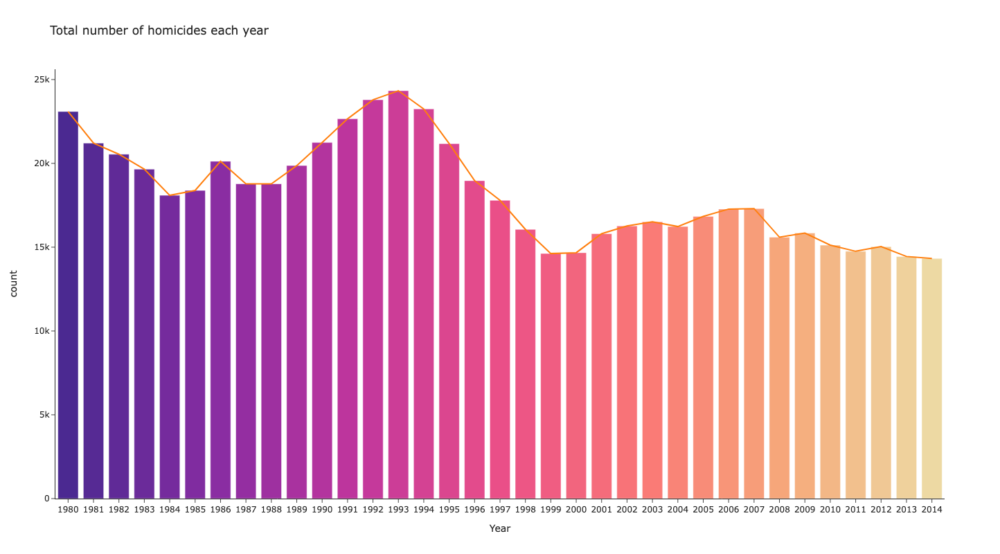

In [10]:
query_df = dataframe.groupBy("Year").count().orderBy("Year").toPandas()
# sns.barplot(data=query_df, x="Year", y="count")
# plt.xticks(
#     rotation=45,
#     horizontalalignment='right',
# )
# plt.tight_layout()
title = "Total number of homicides each year"
fig = px.bar(query_df, x="Year", y="count", color=list(range(len(query_df))), color_continuous_scale="agsunset", title=title)
fig.add_traces(plotly.graph_objects.Scatter(x=list(query_df["Year"]), y=list(query_df["count"]), mode='lines'))
fig.update_layout(width=1500, height=800, showlegend=False)
fig.update_coloraxes(showscale=False)
fig.show()

#### Weapon of choice for different Perpetrator Sexes

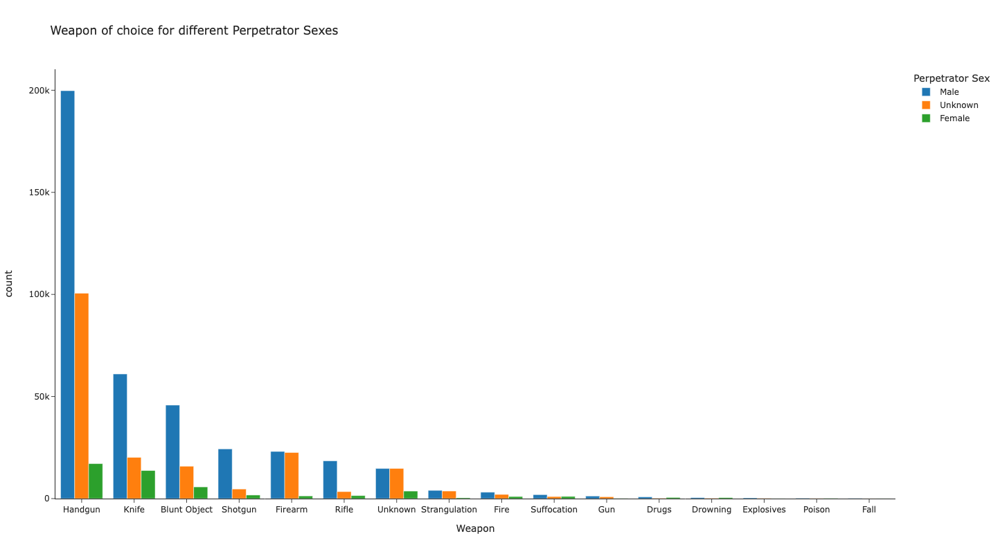

In [11]:
query_df = dataframe.groupBy("Weapon", "Perpetrator Sex").count().sort(col("count").desc()).toPandas()
# sns.barplot(query_df, x="Weapon", y="count", hue="Perpetrator Sex")\
#         .set_title(f"Murder Weapon counts - Solved and not solved")
# plt.xticks(
#     rotation=45,
#     horizontalalignment='right',
# )
# plt.tight_layout()
# fig = px.bar(query_df, x="Year", y="count", color=list(range(len(query_df))), color_continuous_scale=px.colors.sequential.Sunsetdark)
title = "Weapon of choice for different Perpetrator Sexes"
fig = px.bar(query_df, x="Weapon", y="count", color="Perpetrator Sex", barmode='group', title=title)
fig.update_layout(width=1400, height=800)
fig.show()

#### Is there a weapon prominently seen in unsolved crimes?

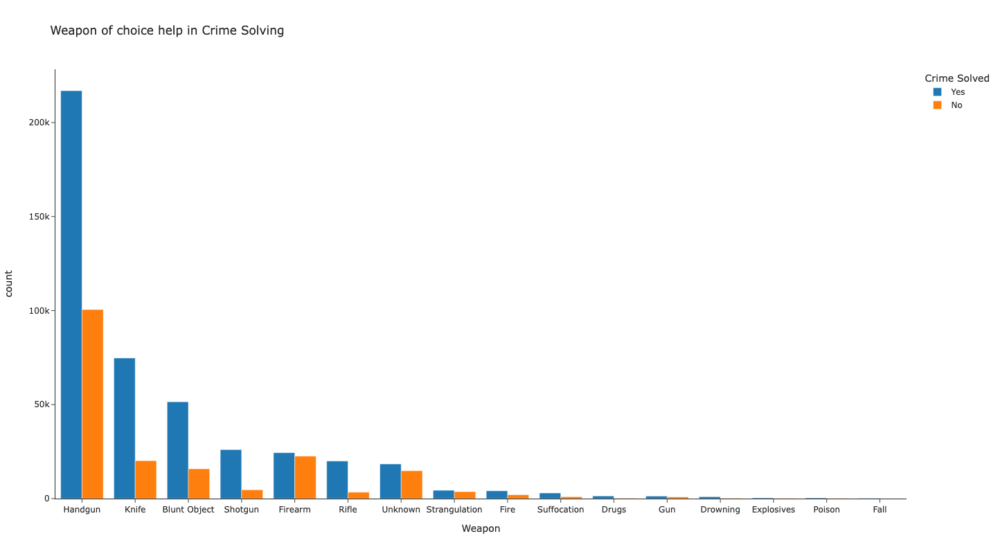

In [12]:
query_df = dataframe.groupBy("Weapon", "Crime Solved").count().sort(col("count").desc()).toPandas()

# sns.barplot(query_df, x="Weapon", y="count", hue="Crime Solved")\
#         .set_title(f"Murder Weapon counts - Solved and not solved")
# plt.xticks(
#     rotation=45,
#     horizontalalignment='right',
# )
# plt.tight_layout()

title = "Weapon of choice help in Crime Solving"
fig = px.bar(query_df, x="Weapon", y="count", color="Crime Solved", barmode='group', title=title)
fig.update_layout(width=1400, height=800)
fig.show()

#### Weapon of choice for a homicide where the Perpetrator and the Victim are Strangers

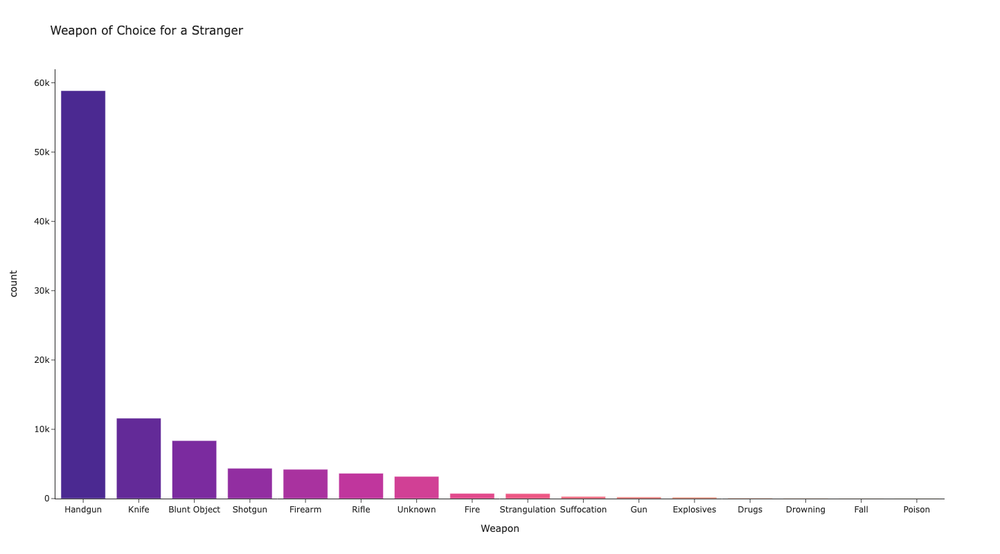

In [13]:
# Stranger's weapon of choice
stranger_df = dataframe.filter(dataframe["Relationship"] == "Stranger")
query_df = stranger_df.groupBy("Weapon").count().sort(col("count").desc()).toPandas()

# sns.barplot(query_df, x="Weapon", y="count").set_title(f"Weapon of choice for strangers")
# plt.xticks(
#     rotation=45,
#     horizontalalignment='right',
# )
# plt.tight_layout()

title = "Weapon of Choice for a Stranger"
fig = px.bar(query_df, x="Weapon", y="count", color=list(range(len(query_df))), color_continuous_scale="agsunset", title=title)
fig.update_layout(width=1400, height=800)
fig.update_coloraxes(showscale=False)
fig.show()

#### Categorizing age by binning, Age groups of the Perpetrators

In [14]:
def age_to_cat_map(age):
    age = int(age)
    if age < 18:
        return "Juvenile"
    elif 18 <= age <= 39:
        return "Young Adult"
    elif 40 <= age <= 59:
        return "Middle Aged Adults"
    elif age>59:
        return "Old"

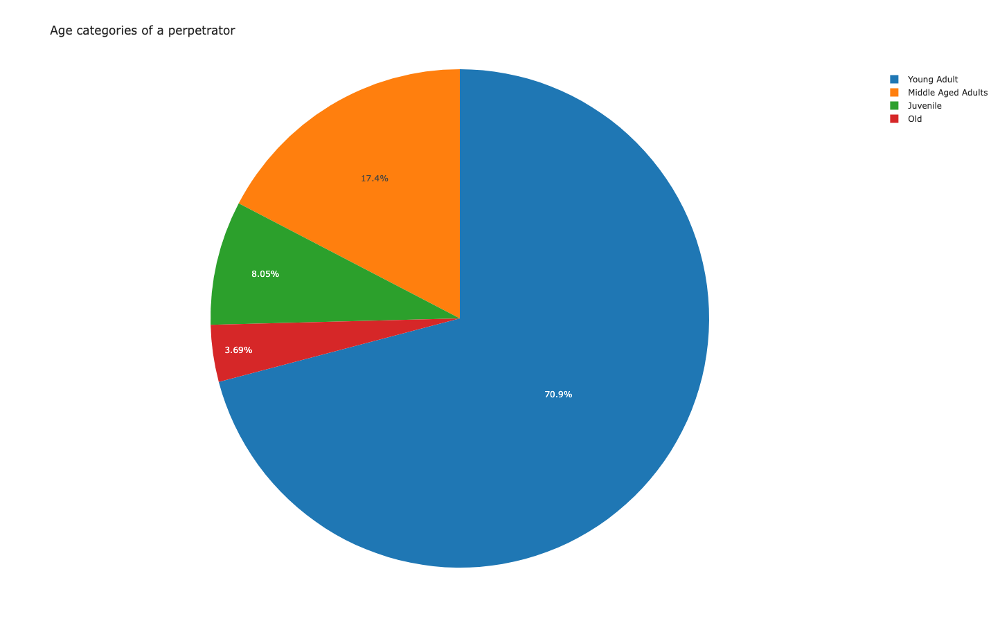

In [15]:
perp_age_cat = dataframe.filter(dataframe["Perpetrator Age"] > 0)
bucket_udf = udf(age_to_cat_map, StringType())
perp_age_cat_pd = perp_age_cat.withColumn("Perpetrator Age Category", bucket_udf("Perpetrator Age"))\
            .groupBy("Perpetrator Age Category").count().orderBy('count').toPandas()

# sns.barplot(perp_age_cat_pd, x="Perpetrator Age Category", y="count")\
#             .set_title(f"Perpetrator age categories")
# plt.tight_layout()

title = "Age categories of a perpetrator"
fig = px.pie(perp_age_cat_pd, names="Perpetrator Age Category", values="count", title=title)
fig.update_coloraxes(showscale=False)
fig.update_layout(width=1200, height=900)
fig.show()

#### Categorizing age by binning, Age groups of the Victims

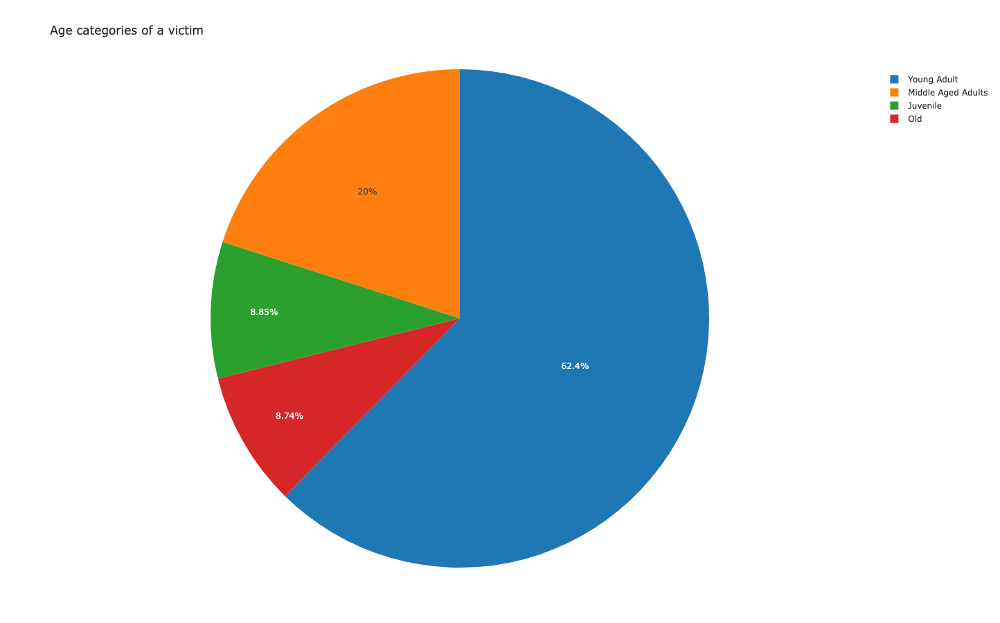

In [16]:
victim_age_cat = dataframe.filter(dataframe["Victim Age"] > 0)
bucket_udf = udf(age_to_cat_map, StringType())
victim_age_cat_pd = victim_age_cat.withColumn("Victim Age Category", bucket_udf("Victim Age"))\
            .groupBy("Victim Age Category").count().orderBy('count').toPandas()

# sns.barplot(victim_age_cat_pd, x="Victim Age Category", y="count")\
#             .set_title(f"Victim age categories")
# plt.tight_layout()

title = "Age categories of a victim"
fig = px.pie(victim_age_cat_pd, names="Victim Age Category", values="count", title=title)
fig.update_coloraxes(showscale=False)
fig.update_layout(width=1200, height=900)
fig.show()

#### Is the perpetrator older than the victim?

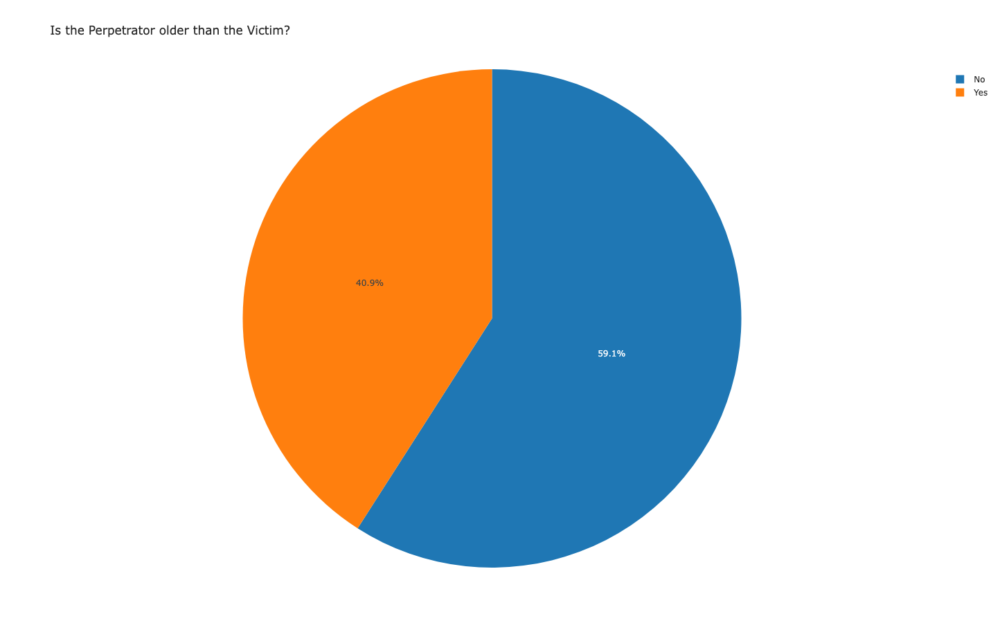

In [17]:
non_zero_age_df = dataframe.filter((dataframe["Victim Age"] > 0) & (dataframe["Perpetrator Age"] > 0))
bucket_udf = udf(age_to_cat_map, StringType())

non_zero_age_df = non_zero_age_df.withColumn("Perp Older", non_zero_age_df["Perpetrator Age"] > non_zero_age_df["Victim Age"])
bool_to_conf_udf = udf(lambda x: "Yes" if x is True else "No", StringType())

non_zero_age_df = non_zero_age_df.withColumn("Perp Older", bool_to_conf_udf("Perp Older"))
perp_older_df = non_zero_age_df.groupBy("Perp Older").count().toPandas()

fig = px.pie(perp_older_df, values='count', names='Perp Older', title="Is the Perpetrator older than the Victim?")
fig.update_layout(width=1200, height=900)
fig.show()

#### Do the perpetrator and the victim share the same race?

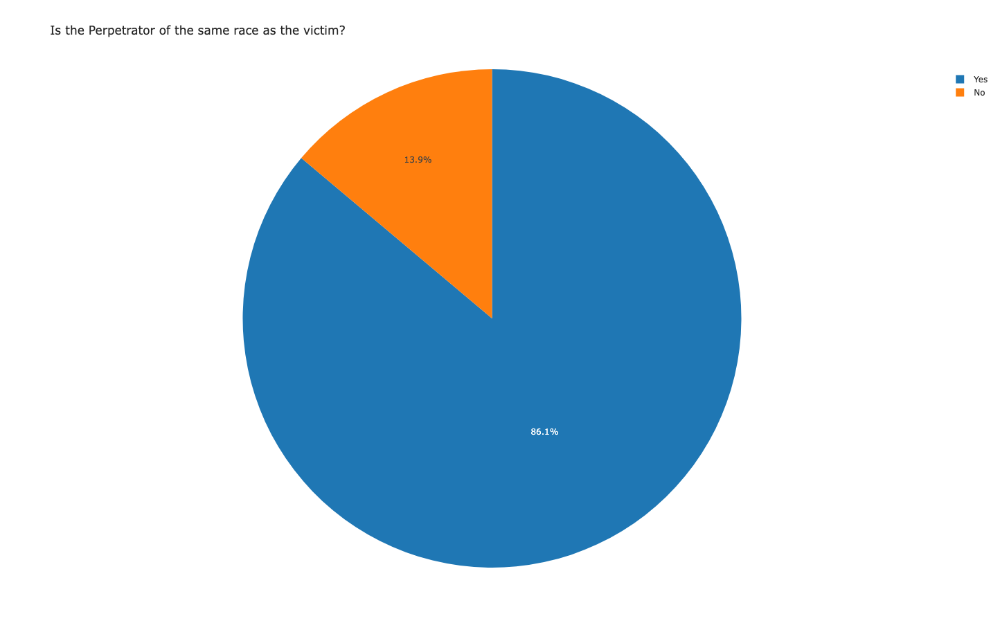

In [18]:
# Is the perpetrator of the same race as the victim?
same_race_df = non_zero_age_df.withColumn("Perp Same Race", non_zero_age_df["Perpetrator Race"] == non_zero_age_df["Victim Race"])
bool_to_conf_udf = udf(lambda x: "Yes" if x is True else "No", StringType())

same_race_df = same_race_df.withColumn("Perp Same Race", bool_to_conf_udf("Perp Same Race"))
same_race_df = same_race_df.groupBy("Perp Same Race").count().toPandas()
fig = px.pie(same_race_df, values='count', names='Perp Same Race', title="Is the Perpetrator of the same race as the victim?")
fig.update_layout(width=1200, height=900)
fig.show()

#### Crime rate spread across the United States

In [19]:
crimes_per_city = dataframe.groupBy("City").count().toPandas()
crimes_per_city = crimes_per_city.rename(columns={"City": "NAME", "count": "Crimes Per City"})

In [20]:
usa = gpd.read_file('https://raw.githubusercontent.com/holtzy/The-Python-Graph-Gallery/master/static/data/US-counties.geojson')
result = pd.merge(usa, crimes_per_city, on="NAME", how="inner")
result["Crimes Per City Log10"] = np.log10(result["Crimes Per City"])

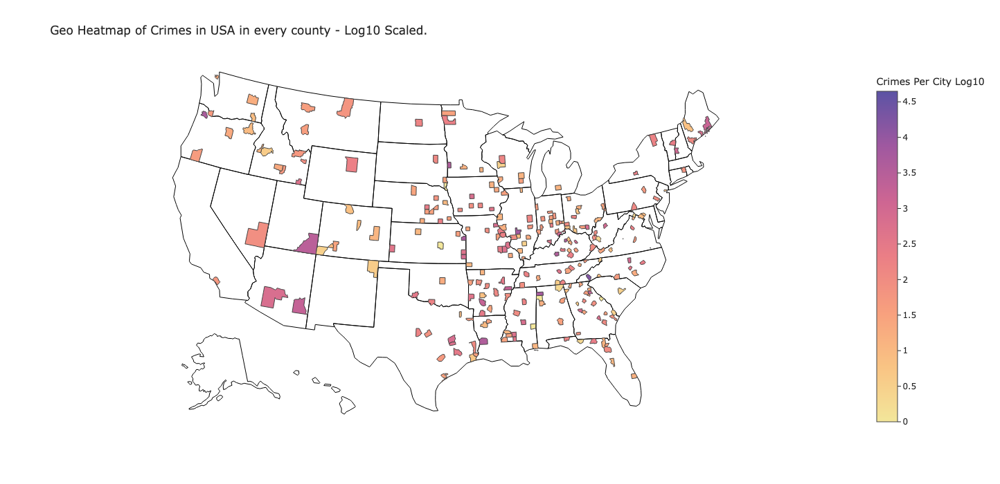

In [21]:
title="Geo Heatmap of Crimes in USA in every county - Log10 Scaled."
fig = px.choropleth(result, geojson=result, locations='COUNTY', color="Crimes Per City Log10", 
                    color_continuous_scale="sunset",
                    # showcountries=True, countrycolor="Black",
                    # showsubunits=True, subunitcolor="Blue",
                    scope="usa", title=title)
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(width=1400, height=700)
fig.update_geos(showsubunits=True, subunitcolor="black")
fig.show()

## Discussion

### Interpretation of the results

+ We can see that "Los Angeles" and "New York City" have the highest number of homicides
+ As a result, the state data corroborates the above story. California and New York are in the top 3.
+ In most of the homicide cases, the Municipal police reports the crime to the agency.
+ July and August seem to have the highest number of homicides.
+ About 70% of the crimes in the dataset are solved.
+ More than 60% of the homicides have been committed by Males.
+ However, more than 75% of the homicide victims are Males.
+ There are a similar number of white and black perpetrators (30% each).
+ However, the number of white victims is 2% more than that of black.
+ Most of the records in this dataset were recorded by the FBI.
+ The number of homicides peaked in the early 1990s, with the number of crimes deacreasing steadily after 2007.
+ Crimes with firearms and Unknown weapons seem to be difficult to solve cases. This makes sense, since forensic analysts may have a hard time analyzing the scene.
+ The weapon of choice seems to be either a handgun or a knife.
+ There is a 50-50 split in the solved vs unsolved crime weapon as a firearm.
+ Murder weapon is an important clue to solve a case. However, the weapon alone does not give us the full picture.
+ If the perpetrator and the victim are strangers, the weapon of choice seems to be a handgun. This makes sense from a mugging standpoint.
+ The above points make a strong case to limit the supply of firearms in the United States, especially to the general public.
+ Most of the perpetrators and victims are young people.
+ However, there seems to be a concerning number of perpetrators and victims who are Juvenile.
+ The victim is older than the perpetrator in most cases.
+ There is a 80-20 split in the question "Do the perpetrator and victim share the same race?".
+ This implies that not many crimes were committed by interracial hatred.
+ The crime rate across the United States is log base 10 scaled.
+ In the geographical plot, there are exponentially more homicides in the blue region than the yellow/white region.

### Technologies / Skills from the Course, Applied in the project

+ Utilize a cloud instance (J2) to run queries with parallel processing using PySpark.
+ Implement a pipeline by downloading, transforming, summarizing, and visualizing the data. A small part of this was covered in the data.world exercise.
+ Since the volume of this dataset is large, I've decided to implement this pipeline in PySpark.

### Barriers/Failures
+ In the J2 instance, my storage and RAM were almost full.
+ I was able to run queries by using PySpark, which optimizes CPU time and RAM usage.
+ I couldn't fill some of the county data in the map.

## Conclusion

+ In this report, we summarize and visualize crime data in the United States from 1980 to 2014.
+ Visualizations answer the questions and provide a clear picture of the data.
+ PySpark is a great tool to perform parallel computing operations. If Pandas was used instead of PySpark, there would've been a memory overflow, since a small instance of J2 comprises of minimal resources.

## References

+ https://www.cdc.gov/nchs/fastats/homicide.htm
+ https://plotly.com/python/plotly-express/
+ https://plotly.com/python/choropleth-maps/
+ https://sparkbyexamples.com/pyspark/
